### Final annotation of Epithelial cells from small intestine (second trimester)


Preprocessing:
- epithelial cells from main object subsetted, then subsetted cells from small intesine, and further subsetted only cells from second trimester and preterm patients
- performed scvi batch correction to prepare objects

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/post_scvi20221124/SI_ST_epi.hvg5000_noRPL.scvi_output.with_annotv2.22021124.h5ad')

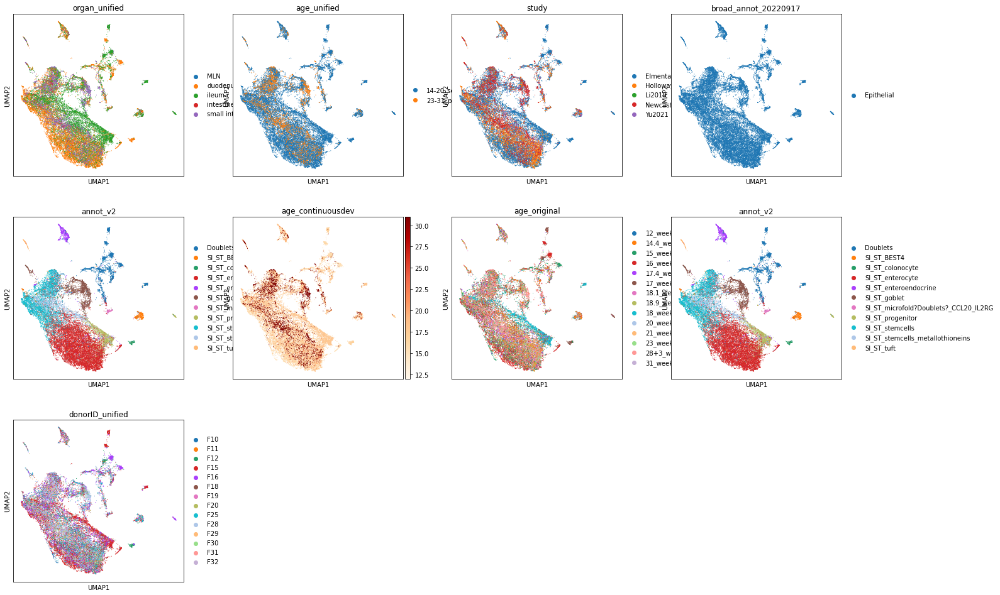

In [6]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata, color=['organ_unified', 'age_unified','study','broad_annot_20220917','annot_v2','age_continuousdev','age_original','annot_v2','donorID_unified'],cmap='OrRd')

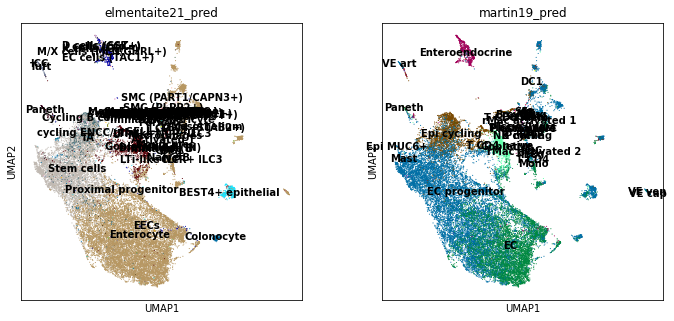

In [7]:
sc.pl.umap(adata, color=['elmentaite21_pred','martin19_pred'],legend_loc='on data')

In [8]:
adata.X.max()

15557.0

In [9]:
#save raw counts in layers
adata.layers['counts'] = adata.X
#normalise and transform
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

In [10]:
adata.X.max()

9.188297

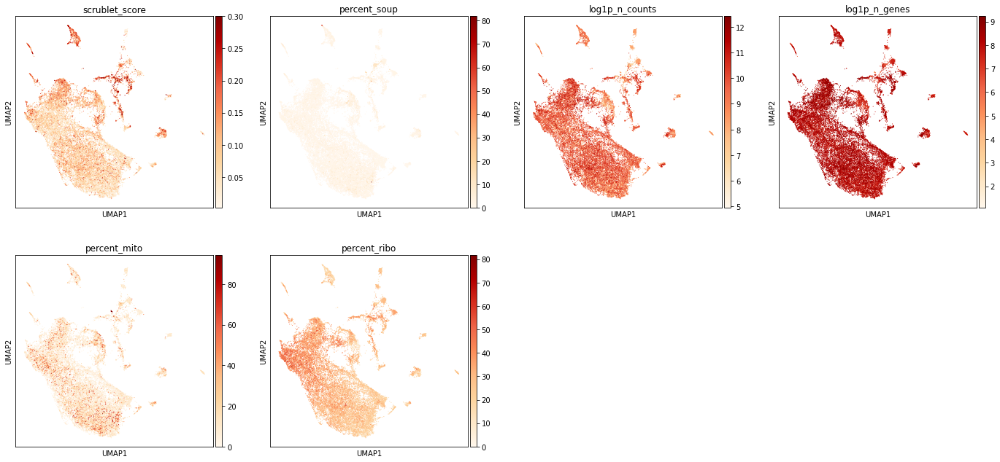

In [11]:
#plot some basic QC
sc.pl.umap(adata, color = ['scrublet_score','percent_soup','log1p_n_counts','log1p_n_genes','percent_mito','percent_ribo'],cmap='OrRd')

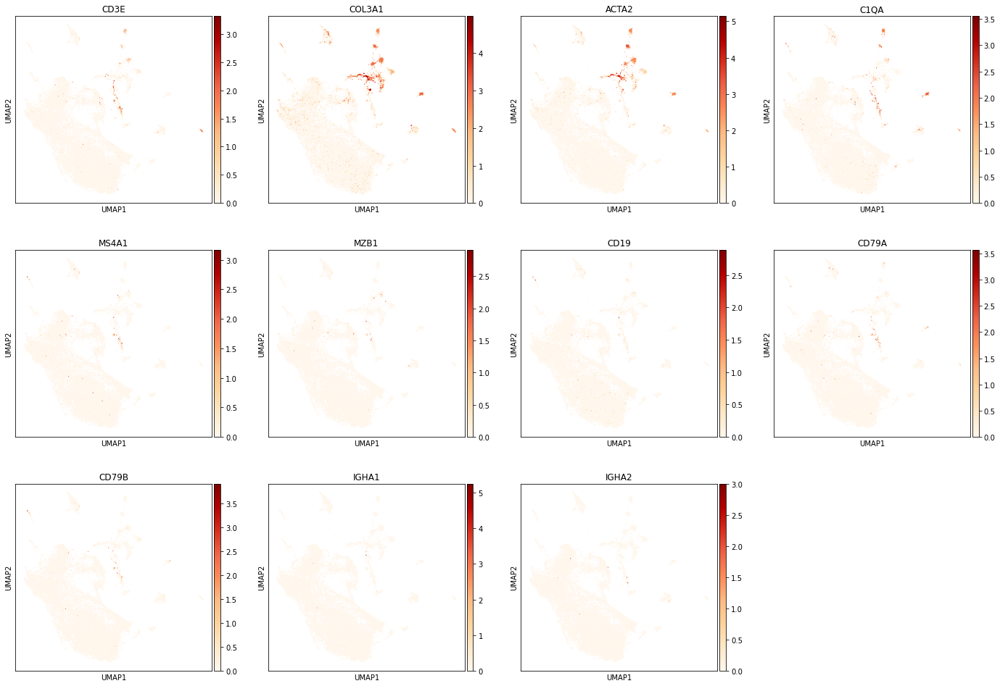

In [12]:
#plot doublet genes
sc.pl.umap(adata, color = ['CD3E','COL3A1','ACTA2','C1QA','MS4A1','MZB1','CD19','CD79A','CD79B','IGHA1','IGHA2'],cmap='OrRd')

In [13]:
#score cell cycle genes
cell_cycle_genes = ['MCM5',
'PCNA',
 'TYMS',
 'FEN1',
 'MCM2',
 'MCM4',
 'RRM1',
 'UNG',
 'GINS2',
 'MCM6',
 'CDCA7',
 'DTL',
 'PRIM1',
 'UHRF1',
 'MLF1IP',
 'HELLS',
 'RFC2',
 'RPA2',
 'NASP',
 'RAD51AP1',
 'GMNN',
 'WDR76',
 'SLBP',
 'CCNE2',
 'UBR7',
 'POLD3',
 'MSH2',
 'ATAD2',
 'RAD51',
 'RRM2',
 'CDC45',
 'CDC6',
 'EXO1',
 'TIPIN',
 'DSCC1',
 'BLM',
 'CASP8AP2',
 'USP1',
 'CLSPN',
 'POLA1',
 'CHAF1B',
 'BRIP1',
 'E2F8',
 'HMGB2',
 'CDK1',
 'NUSAP1',
 'UBE2C',
 'BIRC5',
 'TPX2',
 'TOP2A',
 'NDC80',
 'CKS2',
 'NUF2',
 'CKS1B',
 'MKI67',
 'TMPO',
 'CENPF',
 'TACC3',
 'FAM64A',
 'SMC4',
 'CCNB2',
 'CKAP2L',
 'CKAP2',
 'AURKB',
 'BUB1',
 'KIF11',
 'ANP32E',
 'TUBB4B',
 'GTSE1',
 'KIF20B',
 'HJURP',
 'CDCA3',
 'HN1',
 'CDC20',
 'TTK',
 'CDC25C',
 'KIF2C',
 'RANGAP1',
 'NCAPD2',
 'DLGAP5',
 'CDCA2',
 'CDCA8',
 'ECT2',
 'KIF23',
 'HMMR',
 'AURKA',
 'PSRC1',
 'ANLN',
 'LBR',
 'CKAP5',
 'CENPE',
 'CTCF',
 'NEK2',
 'G2E3',
 'GAS2L3',
 'CBX5',
 'CENPA']

In [14]:
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)
adata = adata[adata.obs.G2M_score.sort_values(ascending=True).index].copy()

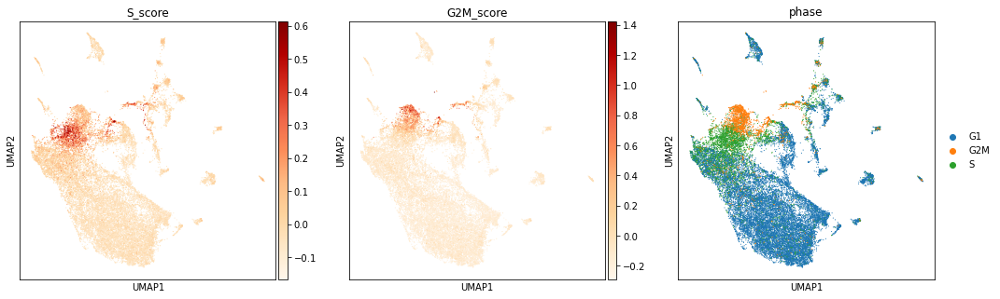

In [15]:
sc.pl.umap(adata,color=['S_score', 'G2M_score', 'phase'],cmap='OrRd')

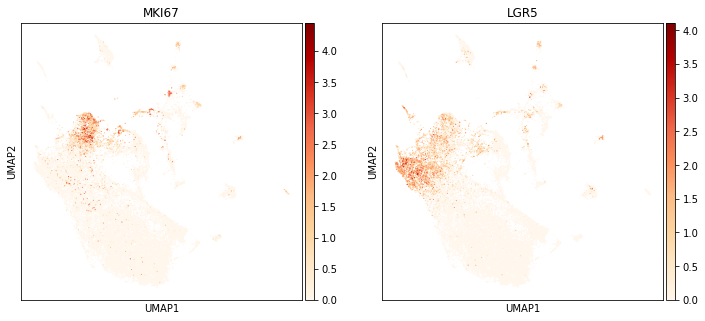

In [16]:
sc.pl.umap(adata,color=['MKI67','LGR5'],cmap='OrRd')

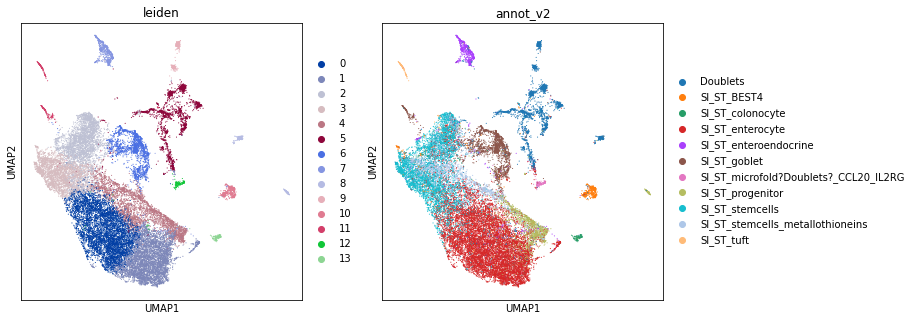

In [23]:
sc.tl.leiden(adata, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(adata,color=['leiden','annot_v2'])

In [24]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *

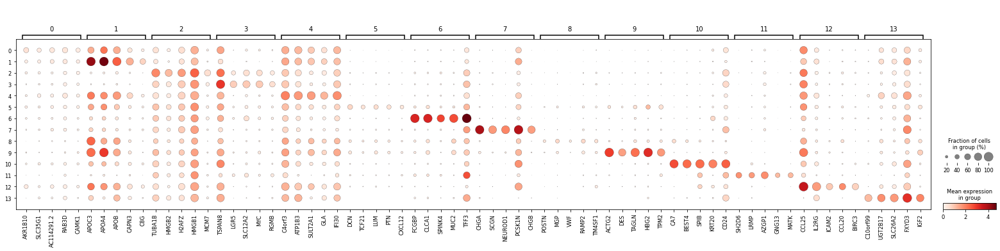

In [25]:
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='leiden', mks=mks)

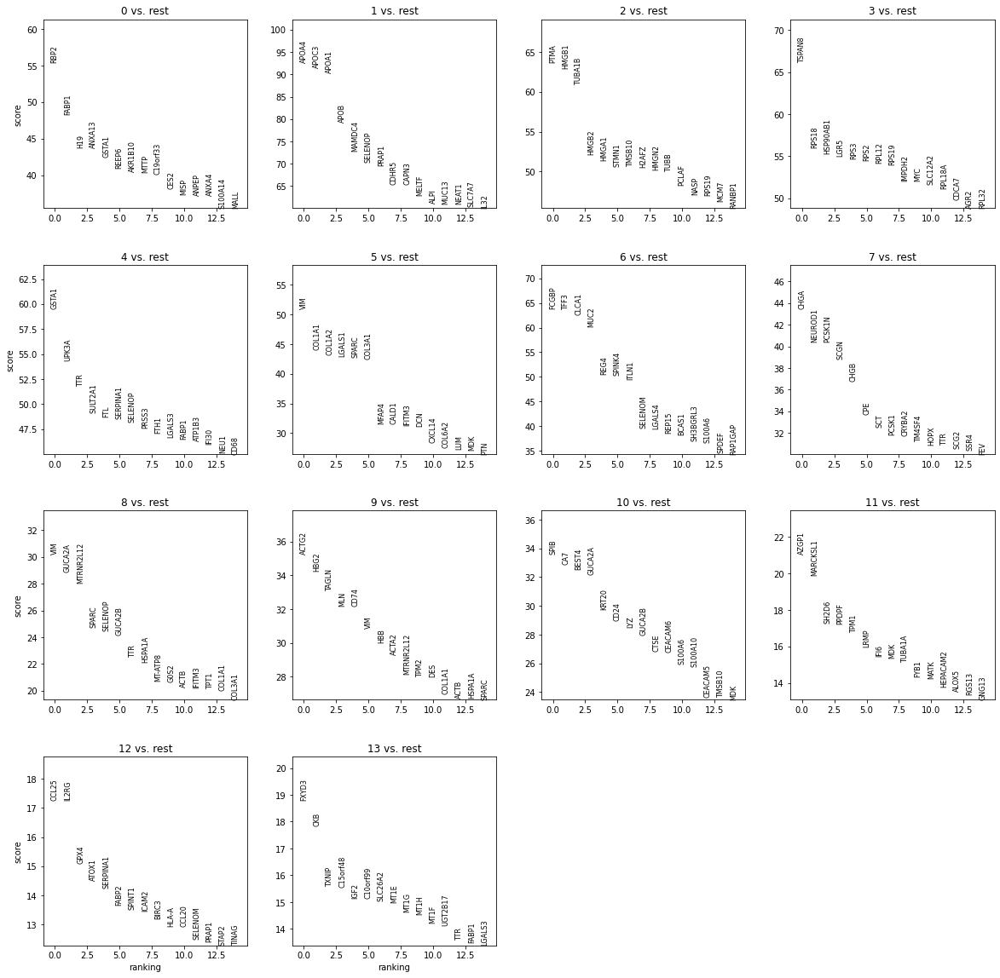

In [27]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=15, sharey=False)

In [26]:
pd.set_option('display.max_columns', 100)
pd.crosstab(adata.obs.annot_v2,adata.obs.leiden)

leiden,0,1,2,3,4,5,6,7,8,9,10,11,12,13
annot_v2,,,,,,,,,,,,,,
Doublets,60,81,90,29,13,1827,21,39,248,455,6,0,2,0
SI_ST_BEST4,17,16,35,79,8,2,13,2,1,0,431,0,1,0
SI_ST_colonocyte,1,1,23,37,7,0,2,0,1,0,0,0,0,135
SI_ST_enterocyte,4602,4441,282,82,951,48,24,1,1,0,5,0,18,0
SI_ST_enteroendocrine,26,21,48,15,7,8,15,708,0,0,1,2,0,0
SI_ST_goblet,43,66,144,74,57,11,1556,1,0,1,5,131,1,1
SI_ST_microfold?Doublets?_CCL20_IL2RG,8,15,9,1,0,6,2,0,0,0,1,0,132,0
SI_ST_progenitor,19,409,3,0,984,10,10,1,219,0,0,0,0,3
SI_ST_stemcells,905,8,2040,1764,100,27,4,0,0,0,0,3,2,0


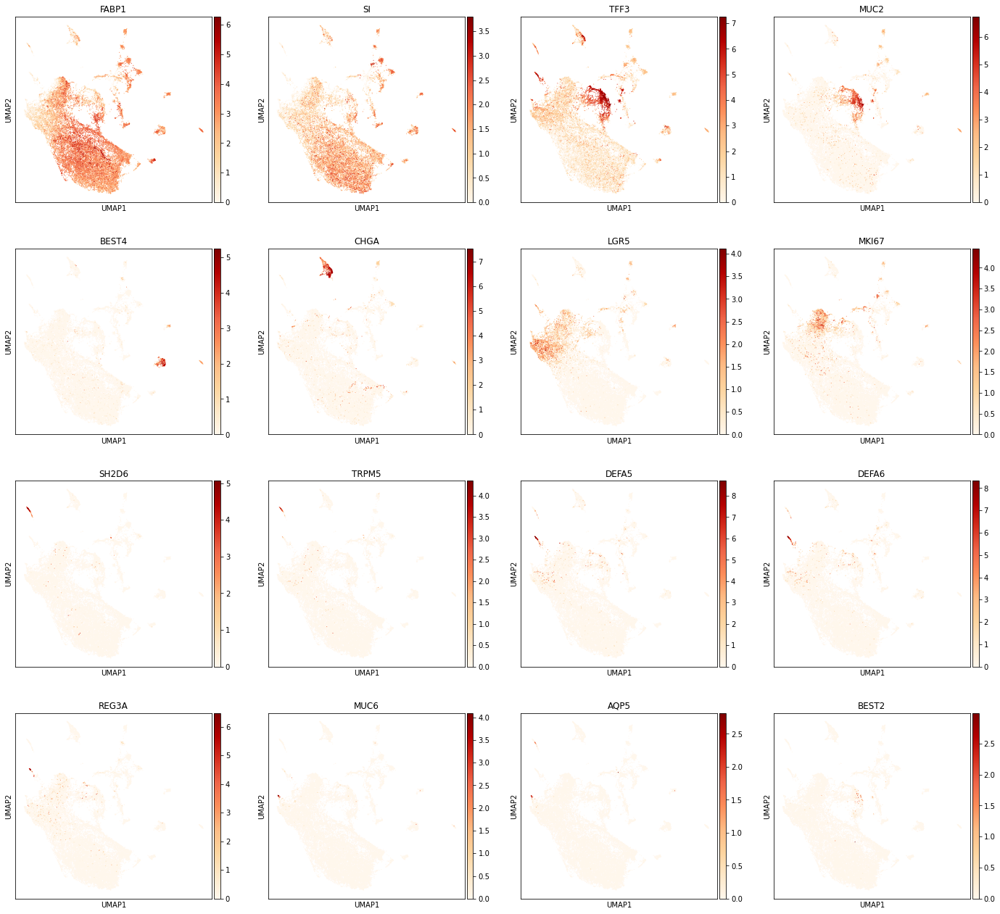

In [154]:
sc.pl.umap(adata,color=['FABP1','SI','TFF3','MUC2','BEST4','CHGA','LGR5','MKI67','SH2D6','TRPM5','DEFA5','DEFA6','REG3A','MUC6','AQP5','BEST2'],cmap='OrRd')

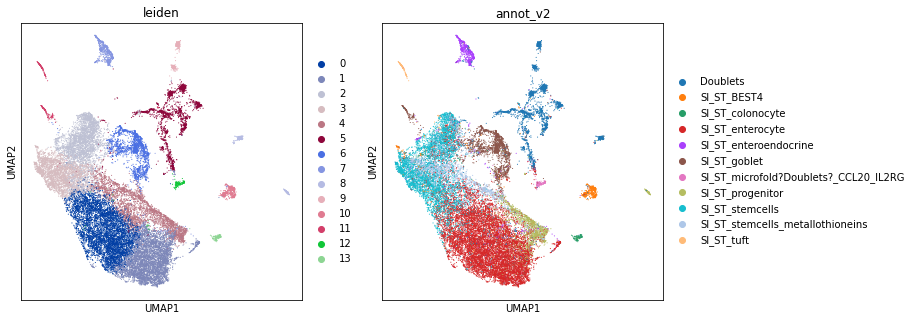

In [33]:
sc.pl.umap(adata,color=['leiden','annot_v2'])

In [34]:
new_cluster_names = [
    'SI_ST_enterocyte','SI_ST_enterocyte', #0,1
    'SI_ST_cycling','SI_ST_stem', #2,3
    'SI_ST_enterocyte?','Doublets', #4,5
    'SI_ST_goblet','SI_ST_enteroendocrine', #6,7 
    'Doublets','Doublets', #8,9
    'SI_ST_BEST4','SI_ST_tuft_paneth',#10,11
    'SI_ST_microfold','SI_ST_colonocyte'#12,13

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

adata.obs['annot_v3'] = [conv[x] for x in adata.obs['leiden']]

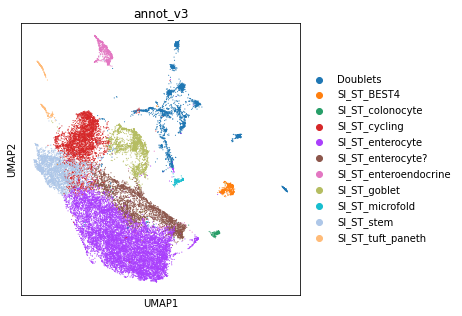

In [35]:
sc.pl.umap(adata,color='annot_v3')

In [36]:
ent = adata[adata.obs.annot_v3.isin(['SI_ST_enterocyte','SI_ST_enterocyte?'])].copy()

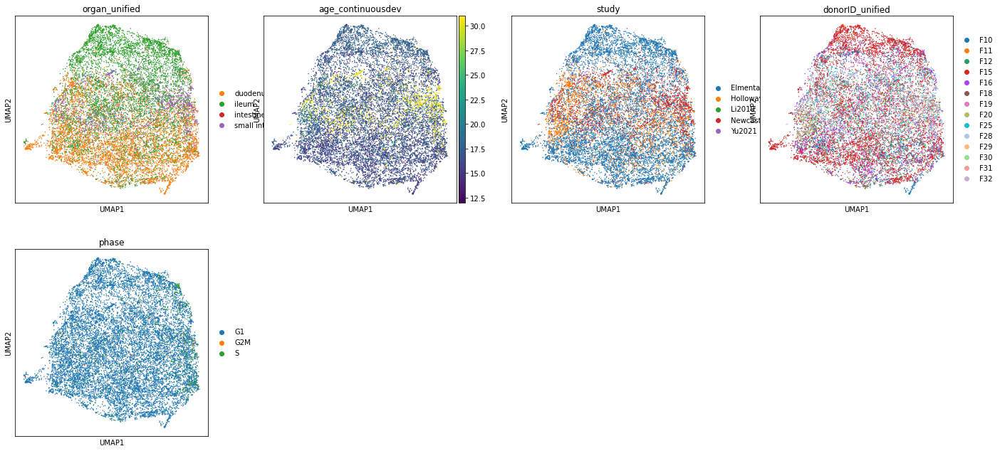

In [38]:
sc.pp.neighbors(
        ent,
            use_rep="X_scvi",
            n_pcs=ent.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(ent, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(ent, color=['organ_unified', 'age_continuousdev','study','donorID_unified','phase'])

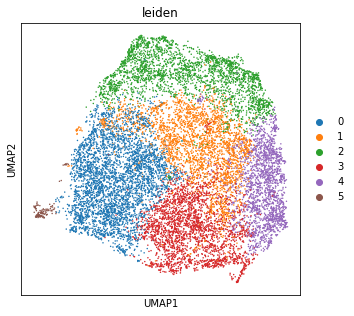

In [39]:
sc.tl.leiden(ent, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(ent, color=['leiden'])

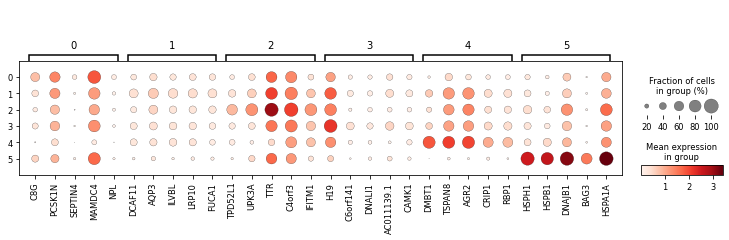

In [40]:
ent.raw = ent.copy()
mkst = calc_marker_stats(ent, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(ent, groupby='leiden', mks=mks)

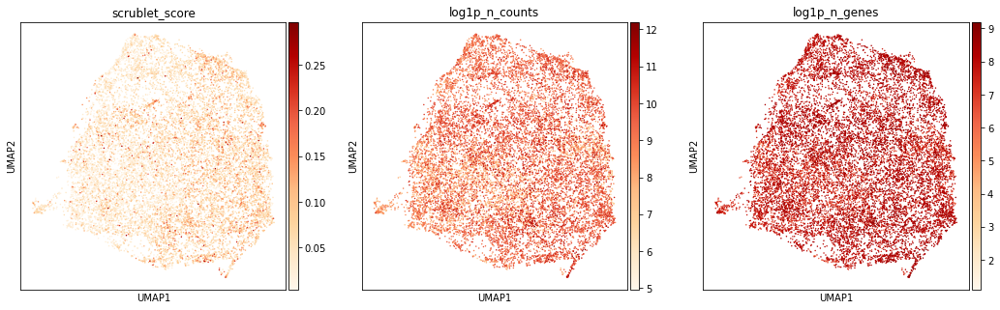

In [42]:
sc.pl.umap(ent,color=['scrublet_score','log1p_n_counts','log1p_n_genes'],cmap='OrRd')

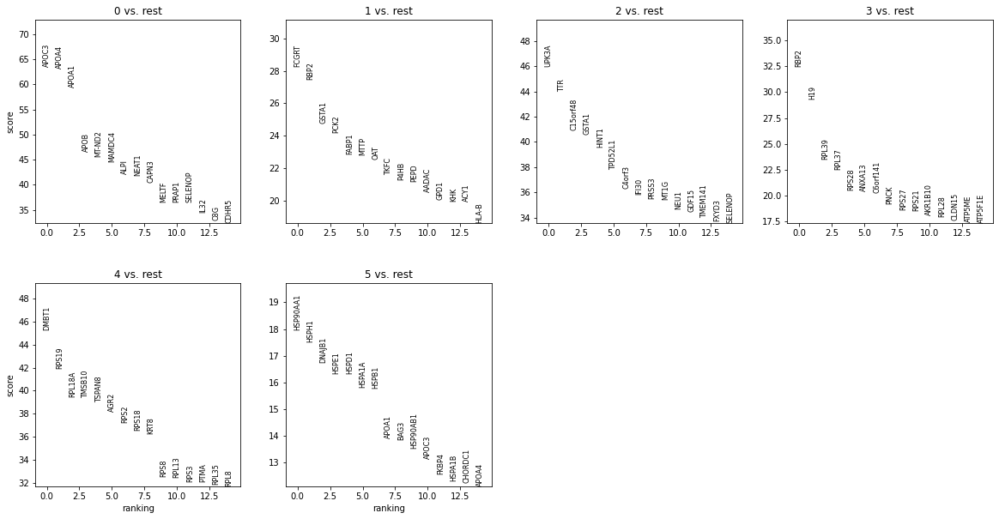

In [43]:
sc.tl.rank_genes_groups(ent, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(ent, n_genes=15, sharey=False)

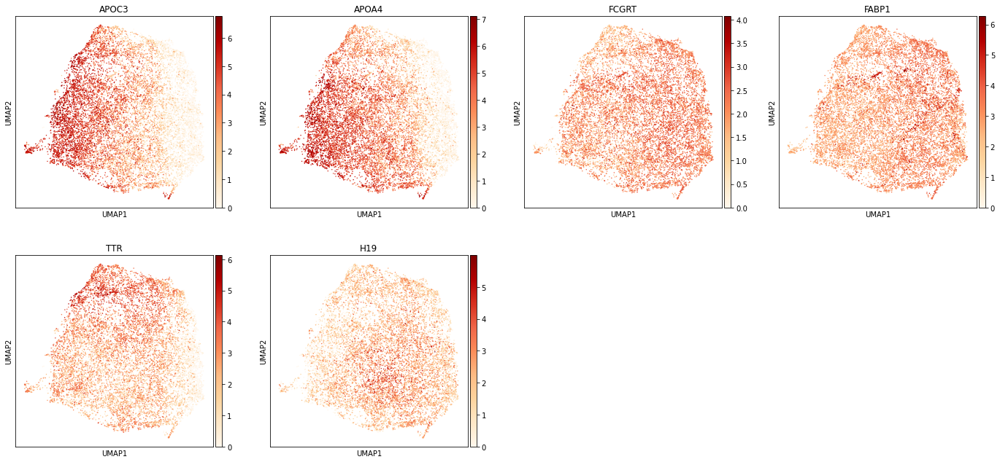

In [45]:
sc.pl.umap(ent,color=['APOC3','APOA4','FCGRT','FABP1','TTR','H19'],cmap='OrRd')

Think there is some distinction between duodenum and ileum in earlier timepoint second trimester, and evens out in the middle - still keep naming the same

In [46]:
new_cluster_names = [
    'SI_ST_enterocyte','SI_ST_enterocyte', #0,1
    'SI_ST_enterocyte','SI_ST_enterocyte', #2,3
    'SI_ST_enterocyte','SI_ST_enterocyte', #4,5

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

ent.obs['annot_v3'] = [conv[x] for x in ent.obs['leiden']]

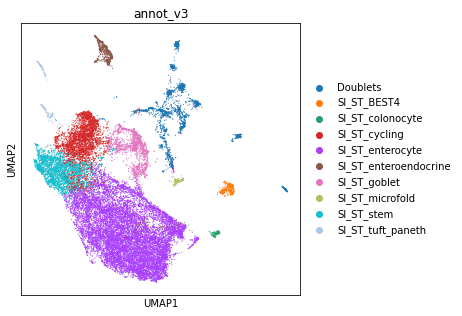

In [47]:
ON = {O:N for O,N in zip(ent.obs_names,ent.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [50]:
gob = adata[adata.obs.annot_v3.isin(['SI_ST_goblet'])].copy()

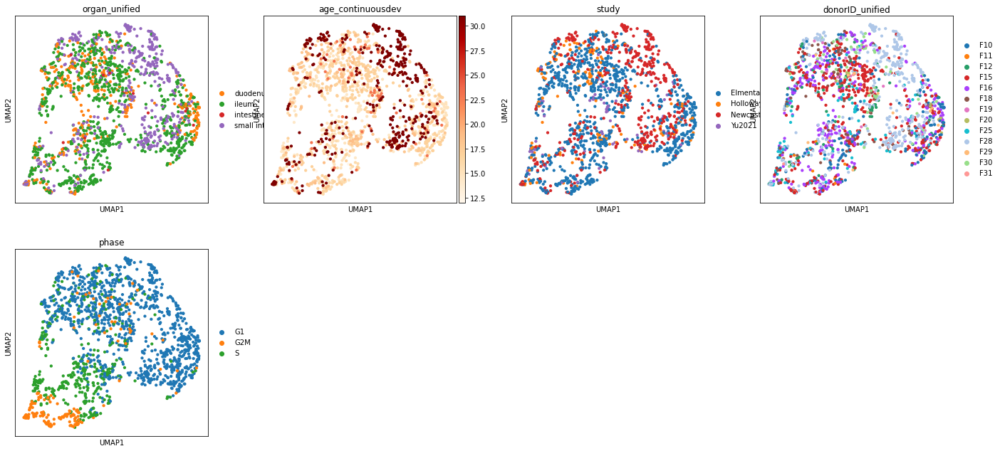

In [51]:
sc.pp.neighbors(
            gob,
            use_rep="X_scvi",
            n_pcs=gob.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(gob, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(gob, color=['organ_unified', 'age_continuousdev','study','donorID_unified','phase'],cmap='OrRd')

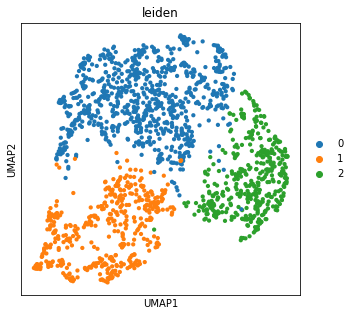

In [52]:
sc.tl.leiden(gob, resolution = 0.2, neighbors_key="neighbors_scvi")
sc.pl.umap(gob, color=['leiden'])

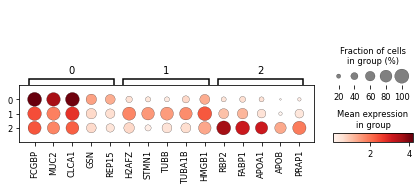

In [54]:
gob.raw = gob.copy()
mkst = calc_marker_stats(gob, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(gob, groupby='leiden', mks=mks)

In [67]:
new_cluster_names = [
    'SI_ST_goblet','SI_ST_cycling_goblet', #0,1
    'SI_ST_goblet'#2

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

gob.obs['annot_v3'] = [conv[x] for x in gob.obs['leiden']]

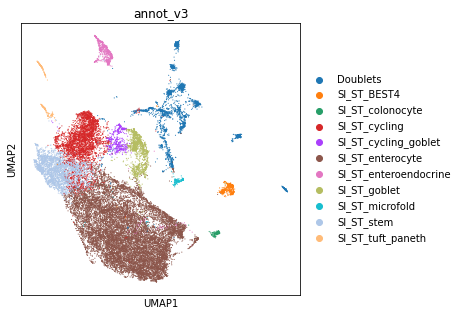

In [68]:
ON = {O:N for O,N in zip(gob.obs_names,gob.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [59]:
cycling = adata[adata.obs.annot_v3.isin(['SI_ST_cycling'])].copy()

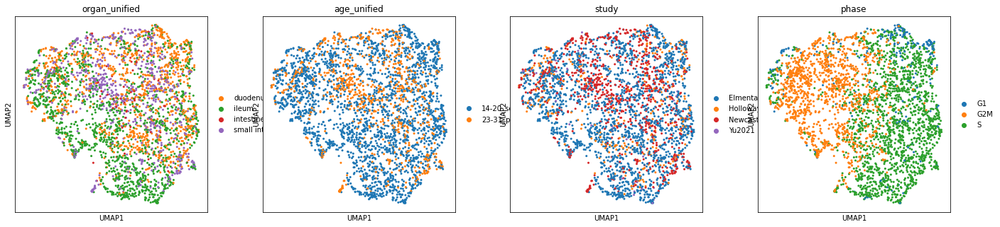

In [60]:
sc.pp.neighbors(
            cycling,
            use_rep="X_scvi",
            n_pcs=cycling.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(cycling, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(cycling, color=['organ_unified', 'age_unified','study','phase'])

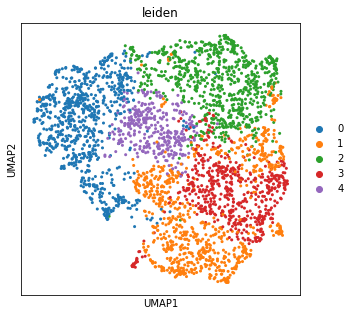

In [65]:
sc.tl.leiden(cycling, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(cycling, color=['leiden'])

In [66]:
pd.crosstab(cycling.obs.leiden,cycling.obs.phase)

phase,G1,G2M,S
leiden,,,
0,61,648,97
1,26,125,654
2,161,127,456
3,18,54,493
4,21,233,100


In [71]:
new_cluster_names = [
    'SI_ST_cycling_G2M','SI_ST_cycling_S', #0,1
    'SI_ST_cycling_S','SI_ST_cycling_S',#2,3
    'SI_ST_cycling_G2M' #4

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

cycling.obs['annot_v3'] = [conv[x] for x in cycling.obs['leiden']]

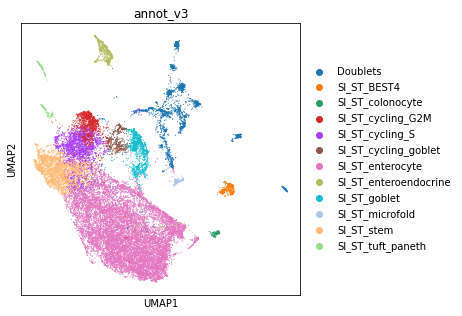

In [72]:
ON = {O:N for O,N in zip(cycling.obs_names,cycling.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [73]:
eec = adata[adata.obs.annot_v3.isin(['SI_ST_enteroendocrine'])].copy()

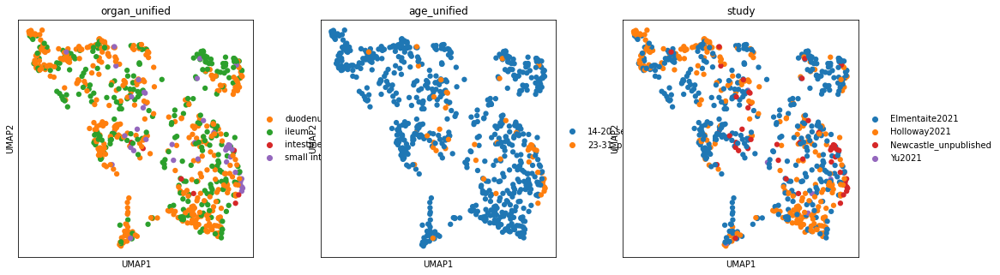

In [74]:
sc.pp.neighbors(
            eec,
            use_rep="X_scvi",
            n_pcs=eec.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(eec, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(eec, color=['organ_unified', 'age_unified','study'])

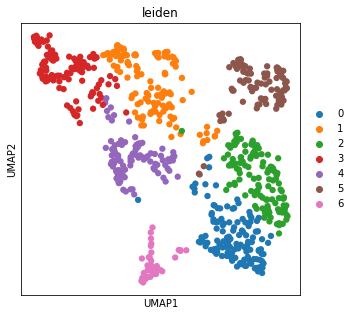

In [77]:
sc.tl.leiden(eec, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(eec, color=['leiden'])

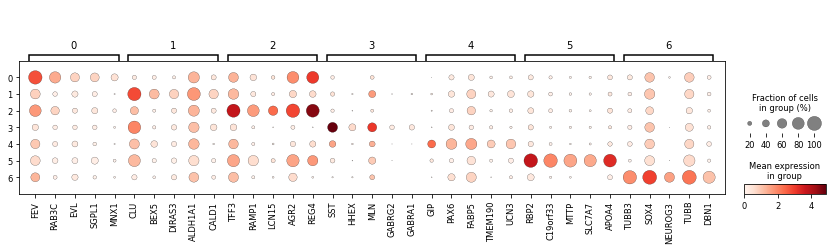

In [78]:
eec.raw = eec.copy()
mkst = calc_marker_stats(eec, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(eec, groupby='leiden', mks=mks)

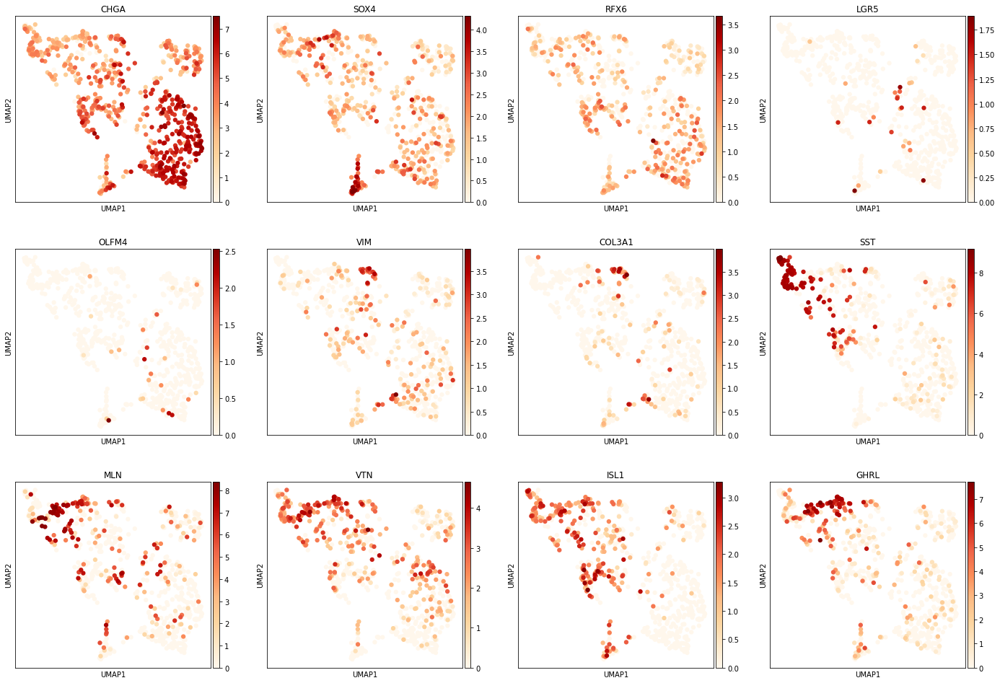

In [79]:
sc.pl.umap(eec,color=['CHGA','SOX4','RFX6','LGR5','OLFM4','VIM','COL3A1','SST','MLN','VTN','ISL1','GHRL'],cmap='OrRd')

In [84]:
new_cluster_names = [
    'SI_ST_enteroendocrine','SI_ST_enteroendocrine', #0,1
    'SI_ST_enteroendocrine','SI_ST_enteroendocrine_mature', #2,3
    'SI_ST_enteroendocrine','SI_ST_enteroendocrine',#4,5 
    'SI_ST_enteroendocrine_SOX4'

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

eec.obs['annot_v3'] = [conv[x] for x in eec.obs['leiden']]

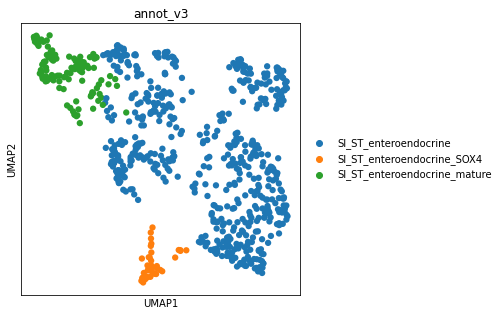

In [85]:
sc.pl.umap(eec,color='annot_v3')

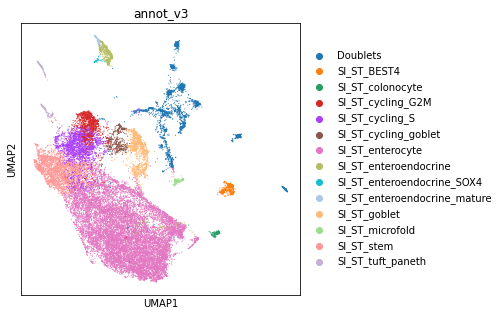

In [86]:
ON = {O:N for O,N in zip(eec.obs_names,eec.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [89]:
tp = adata[adata.obs.annot_v3.isin(['SI_ST_tuft_paneth'])].copy()

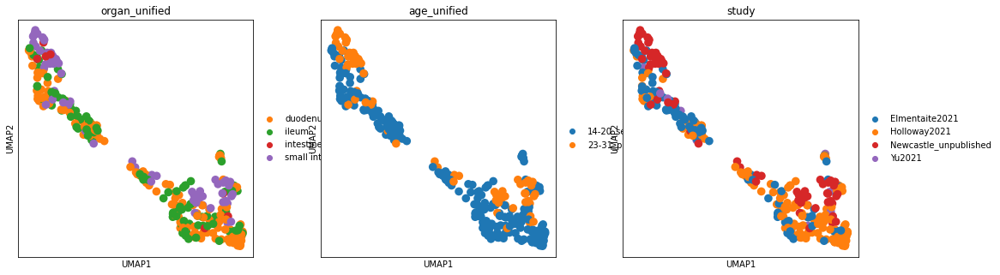

In [90]:
sc.pp.neighbors(
            tp,
            use_rep="X_scvi",
            n_pcs=tp.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(tp, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(tp, color=['organ_unified', 'age_unified','study'])

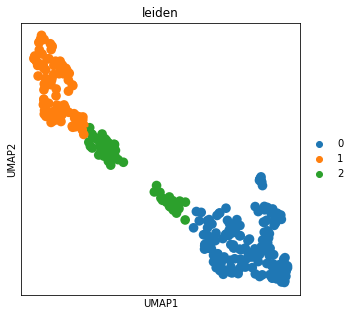

In [95]:
sc.tl.leiden(tp, resolution = 0.2, neighbors_key="neighbors_scvi")
sc.pl.umap(tp, color=['leiden'])

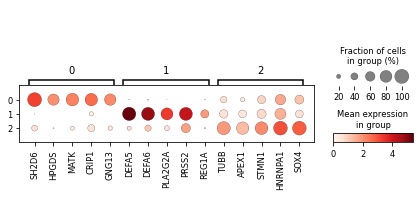

In [96]:
tp.raw = tp.copy()
mkst = calc_marker_stats(tp, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(tp, groupby='leiden', mks=mks)

Possibly dail end with TUBB, STMN1, SOX4 are progenitors, recluster with resolution0.1 and annotate as tuft or paneth

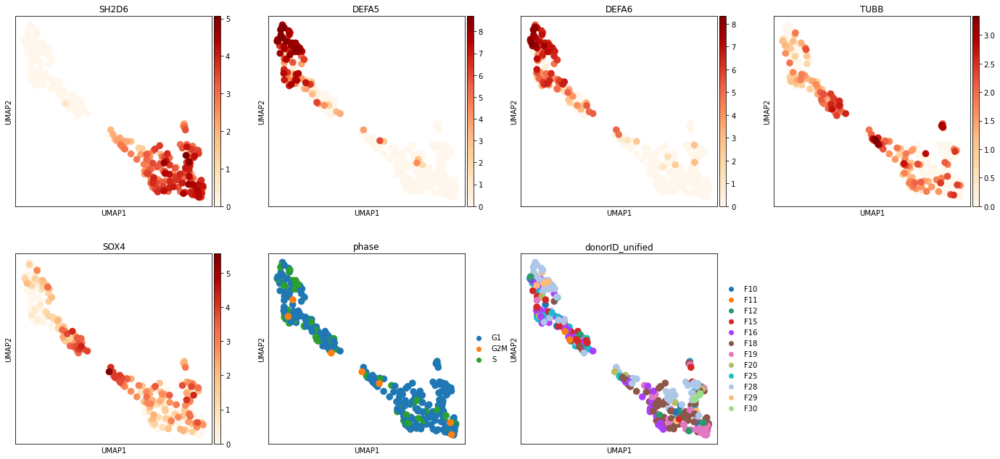

In [106]:
sc.pl.umap(tp,color=['SH2D6','DEFA5','DEFA6','TUBB','SOX4','phase','donorID_unified'],cmap='OrRd')

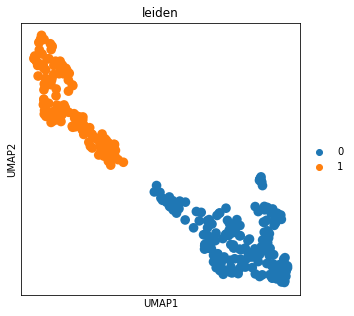

In [100]:
sc.tl.leiden(tp, resolution = 0.1, neighbors_key="neighbors_scvi")
sc.pl.umap(tp, color=['leiden'])

In [101]:
new_cluster_names = [
    'SI_ST_tuft','SI_ST_paneth' #0,1

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

tp.obs['annot_v3'] = [conv[x] for x in tp.obs['leiden']]

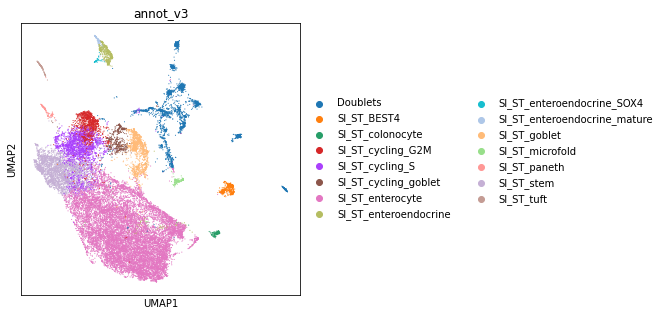

In [102]:
ON = {O:N for O,N in zip(tp.obs_names,tp.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [103]:
b4 = adata[adata.obs.annot_v3.isin(['SI_ST_BEST4'])].copy()

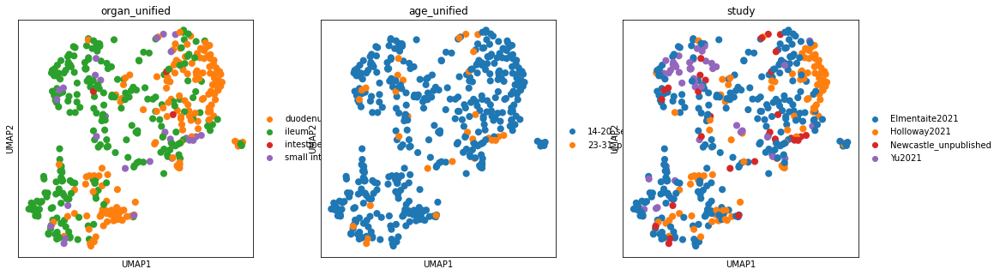

In [121]:
sc.pp.neighbors(
            b4,
            use_rep="X_scvi",
            n_pcs=b4.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(b4, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(b4, color=['organ_unified', 'age_unified','study'])

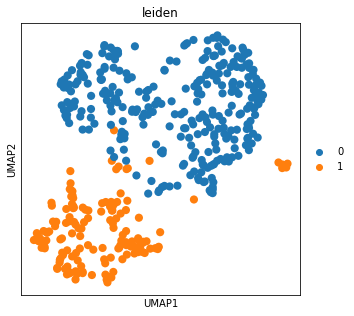

In [122]:
sc.tl.leiden(b4, resolution = 0.2, neighbors_key="neighbors_scvi")
sc.pl.umap(b4, color=['leiden'])

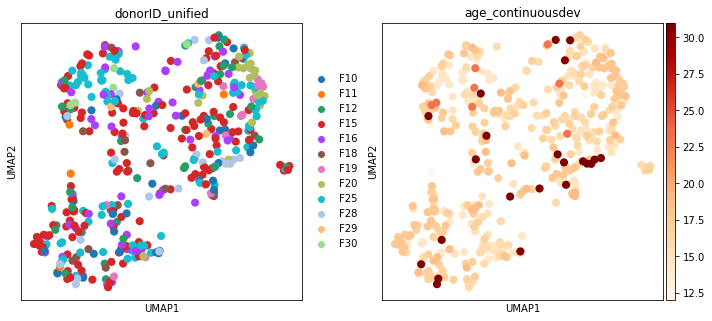

In [123]:
sc.pl.umap(b4,color=['donorID_unified','age_continuousdev'],cmap='OrRd')

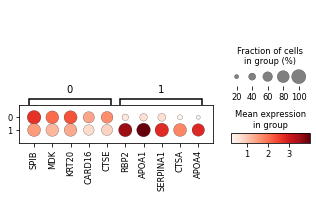

In [124]:
b4.raw = b4.copy()
mkst = calc_marker_stats(b4, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(b4, groupby='leiden', mks=mks)

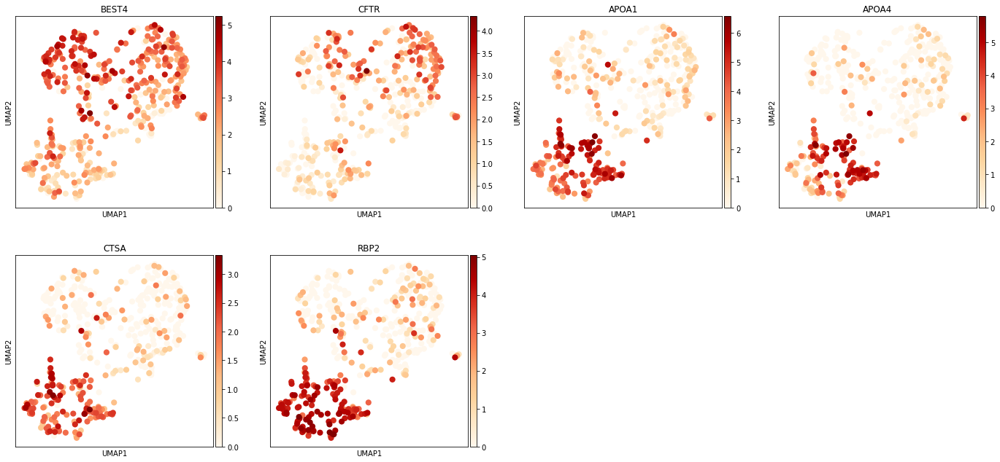

In [125]:
sc.pl.umap(b4,color=['BEST4','CFTR','APOA1','APOA4','CTSA','RBP2'],cmap='OrRd')

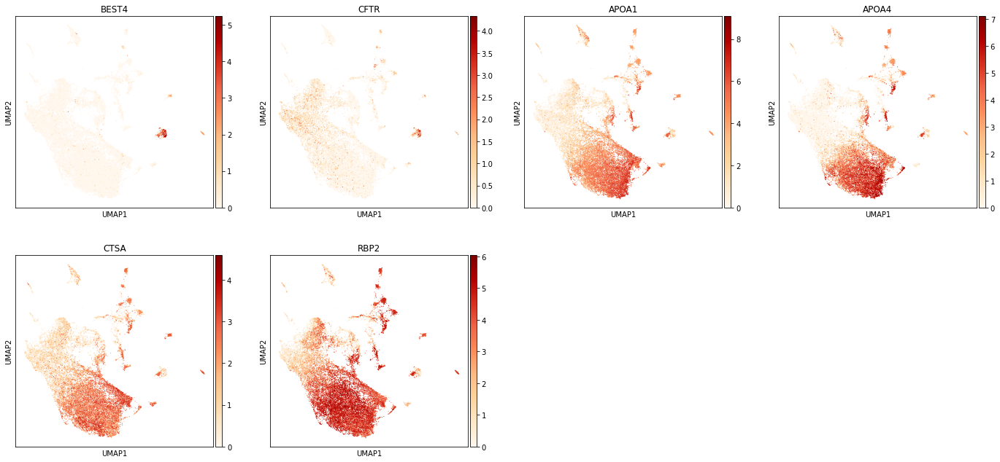

In [117]:
sc.pl.umap(adata,color=['BEST4','CFTR','APOA1','APOA4','CTSA','RBP2'],cmap='OrRd')

In [126]:
new_cluster_names = [
    'SI_ST_BEST4','Doublets' #0,1

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

b4.obs['annot_v3'] = [conv[x] for x in b4.obs['leiden']]

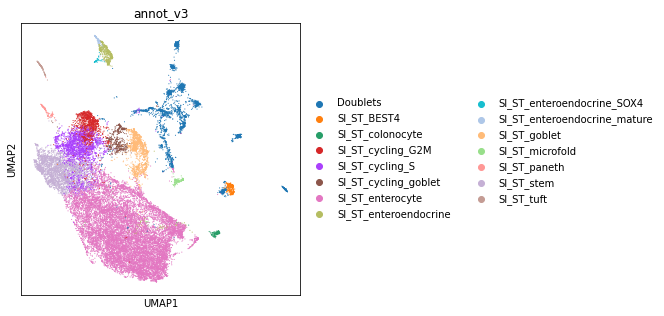

In [127]:
ON = {O:N for O,N in zip(b4.obs_names,b4.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [120]:
stem = adata[adata.obs.annot_v3.isin(['SI_ST_stem'])].copy()

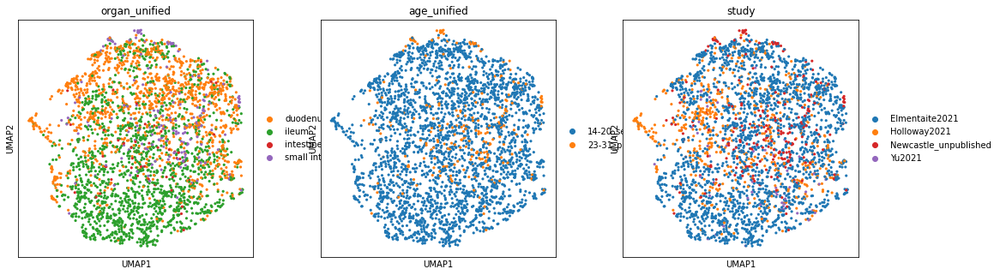

In [128]:
sc.pp.neighbors(
            stem,
            use_rep="X_scvi",
            n_pcs=stem.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(stem, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(stem, color=['organ_unified', 'age_unified','study'])

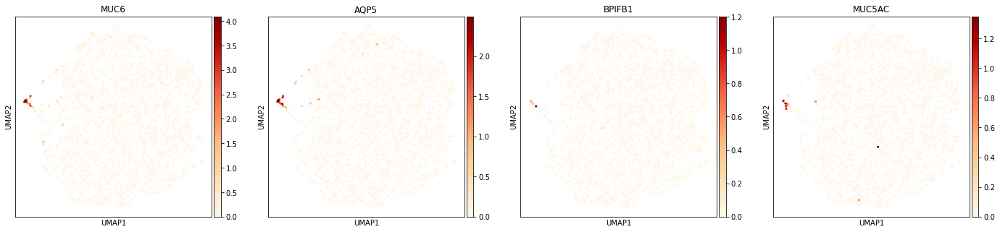

In [132]:
sc.pl.umap(stem,color=['MUC6','AQP5','BPIFB1','MUC5AC'],cmap='OrRd')

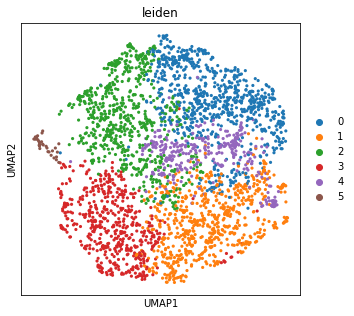

In [133]:
sc.tl.leiden(stem, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(stem, color=['leiden'])

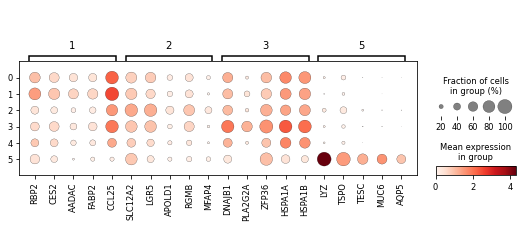

In [134]:
stem.raw = stem.copy()
mkst = calc_marker_stats(stem, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(stem, groupby='leiden', mks=mks)

In [135]:
new_cluster_names = [
    'SI_ST_stem','SI_ST_stem', #0,1
    'SI_ST_stem','SI_ST_stem',#2,3
    'SI_ST_stem','SI_ST_MUC6/MUC5AC'

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

stem.obs['annot_v3'] = [conv[x] for x in stem.obs['leiden']]

In [136]:
m6 = stem[stem.obs.annot_v3.isin(['SI_ST_MUC6/MUC5AC'])].copy()

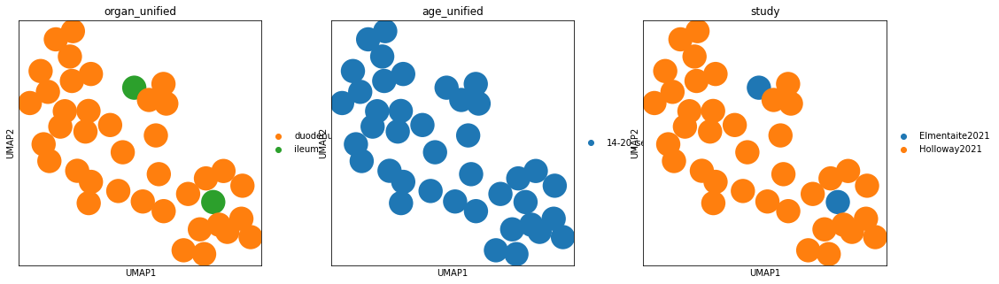

In [137]:
sc.pp.neighbors(
            m6,
            use_rep="X_scvi",
            n_pcs=m6.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(m6, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(m6, color=['organ_unified', 'age_unified','study'])

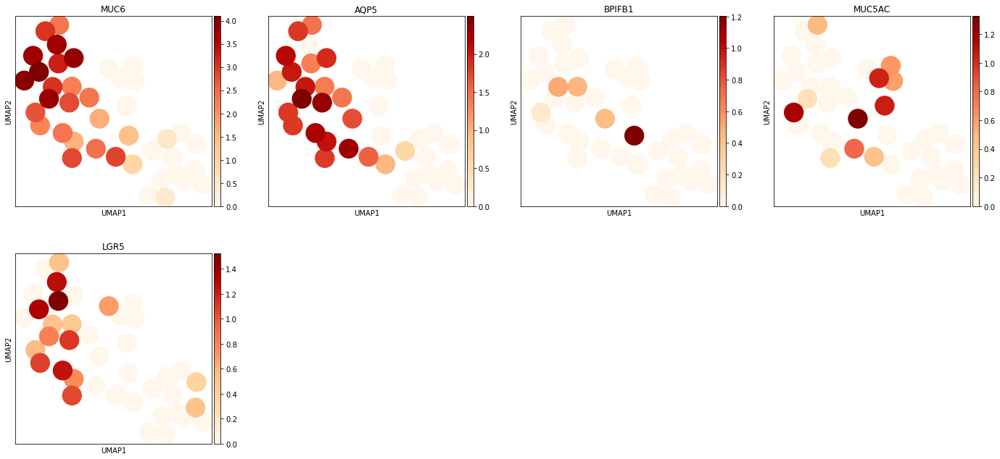

In [141]:
sc.pl.umap(m6,color=['MUC6','AQP5','BPIFB1','MUC5AC','LGR5'],cmap='OrRd')

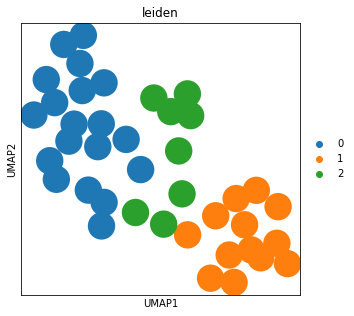

In [140]:
sc.tl.leiden(m6, resolution = 1, neighbors_key="neighbors_scvi")
sc.pl.umap(m6, color=['leiden'])

In [142]:
m6.obs.leiden.value_counts()

0    19
1    13
2     8
Name: leiden, dtype: int64

Possibly should leave combined, will keep detail and remove later after a second opinion

In [143]:
new_cluster_names = [
    'SI_ST_MUC6','SI_ST_stem', #0,1
    'SI_ST_MUC5AC'#2

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

m6.obs['annot_v3'] = [conv[x] for x in m6.obs['leiden']]

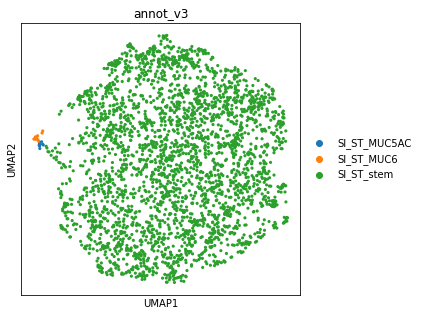

In [144]:
ON = {O:N for O,N in zip(m6.obs_names,m6.obs["annot_v3"])}
stem.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(stem.obs_names, stem.obs["annot_v3"])]
sc.pl.umap(stem,color='annot_v3')

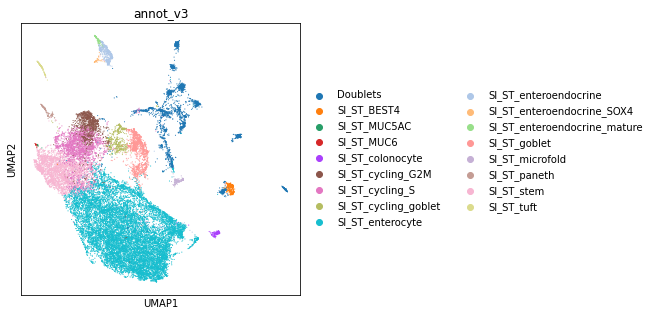

In [145]:
ON = {O:N for O,N in zip(stem.obs_names,stem.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [146]:
adata.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/SI_ST_epi.hvg5000_noRPL.scvi_output.annotv3.20221201.h5ad')

In [147]:
annot = adata.obs.loc[:,['annot_v2','annot_v3']]

In [148]:
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/compartment_annotations/csv/SI_ST_epi_annot_v3_draft.csv')

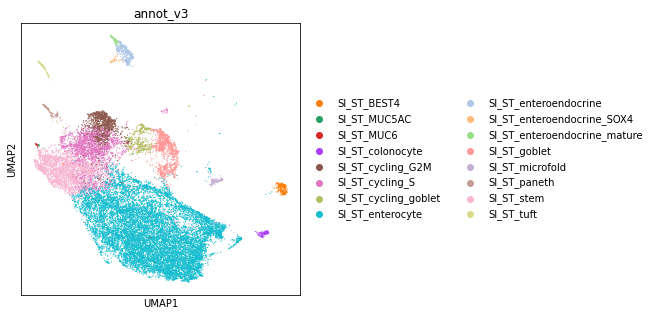

In [149]:
adata_nodoublets = adata[~adata.obs.annot_v3.isin(['Doublets'])].copy()
sc.pl.umap(adata_nodoublets,color='annot_v3')

In [150]:
adata_nodoublets.X.max()

9.188297

In [151]:
#recover raw
adata_nodoublets.X = adata_nodoublets.layers['counts']

In [152]:
adata_nodoublets.X.max()

15557.0

In [153]:
adata_nodoublets.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/pre_scvi20221124/no_doublets/SI_ST_epi.raw.annotv3.nodoublets.20221201.h5ad')

In [2]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/SI_ST_epi.hvg5000_noRPL.scvi_output.annotv3.20221201.h5ad')

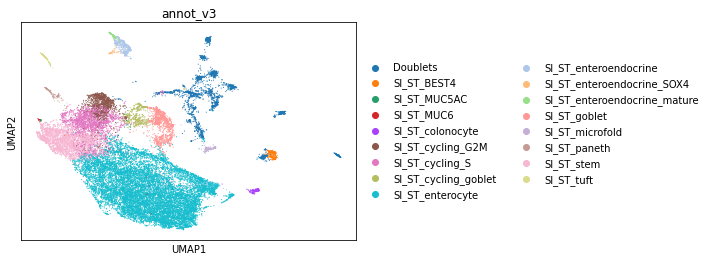

In [3]:
sc.pl.umap(adata,color='annot_v3')

In [4]:
adata.obs['annot_v3'] = (
    adata.obs["annot_v3"]
    .map(lambda x: {'SI_ST_enteroendocrine_SOX4':'SI_ST_enteroendocrine_progenitor'}.get(x, x))
    .astype("category")
)

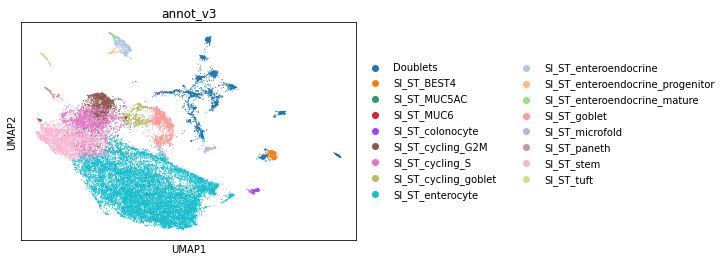

In [5]:
sc.pl.umap(adata,color='annot_v3')

In [2]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/SI_ST_epi.hvg5000_noRPL.scvi_output.annotv3.20221206.h5ad')

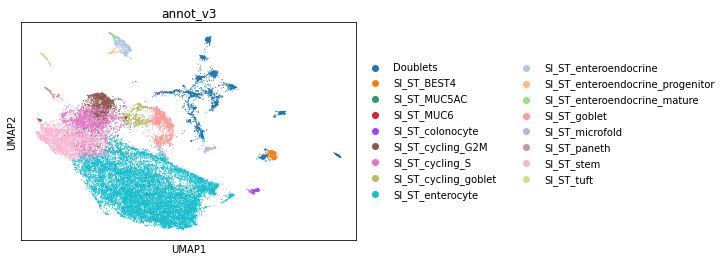

In [3]:
sc.pl.umap(adata,color='annot_v3')

In [4]:
adata.obs['annot_v3'] = (
    adata.obs["annot_v3"]
    .map(lambda x: {'SI_ST_enteroendocrine_mature':'SI_ST_enteroendocrine'
    }.get(x, x))
    .astype("category")
)

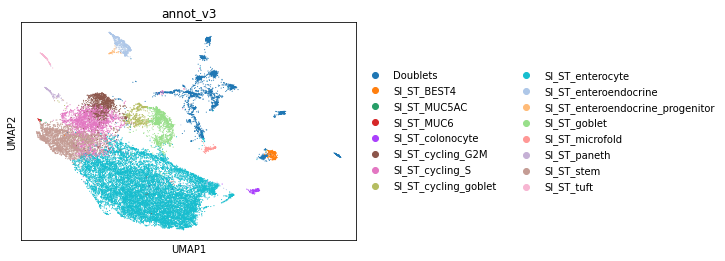

In [5]:
sc.pl.umap(adata,color='annot_v3')

In [6]:
adata.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/SI_ST_epi.hvg5000_noRPL.scvi_output.annotv3.20221206.h5ad')

In [7]:
annot = adata.obs.loc[:,['annot_v2','annot_v3']]

In [8]:
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/compartment_annotations/csv/SI_ST_epi_annot_v3_draft.csv')

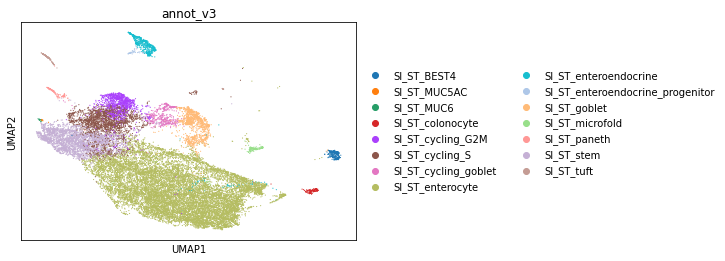

In [9]:
adata_nodoublets = adata[~adata.obs.annot_v3.isin(['Doublets'])].copy()
sc.pl.umap(adata_nodoublets,color='annot_v3')

In [10]:
#recover raw
adata_nodoublets.X = adata_nodoublets.layers['counts']

In [11]:
adata_nodoublets.X.max()

15557.0

In [12]:
adata_nodoublets.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/pre_scvi20221124/no_doublets/SI_ST_epi.raw.annotv3.nodoublets.20221206.h5ad')

In [2]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/SI_ST_epi.hvg5000_noRPL.scvi_output.annotv3.20221206.h5ad')

In [3]:
adata.obs['annot_v3'] = (
    adata.obs["annot_v3"]
    .map(lambda x: {'SI_ST_cycling_goblet':'SI_ST_goblet_cycling'
    }.get(x, x))
    .astype("category")
)

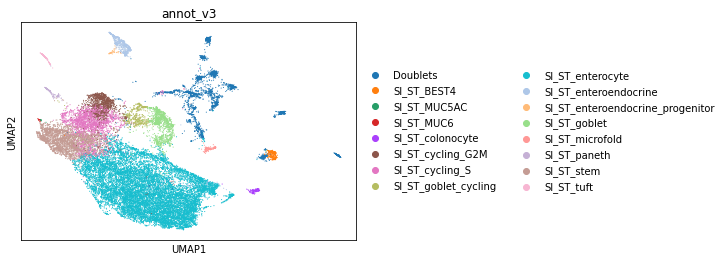

In [4]:
sc.pl.umap(adata,color='annot_v3')

In [5]:
adata.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/SI_ST_epi.hvg5000_noRPL.scvi_output.annotv3.20221206.h5ad')

In [6]:
annot = adata.obs.loc[:,['annot_v2','annot_v3']]

In [7]:
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/compartment_annotations/csv/SI_ST_epi_annot_v3_draft.csv')

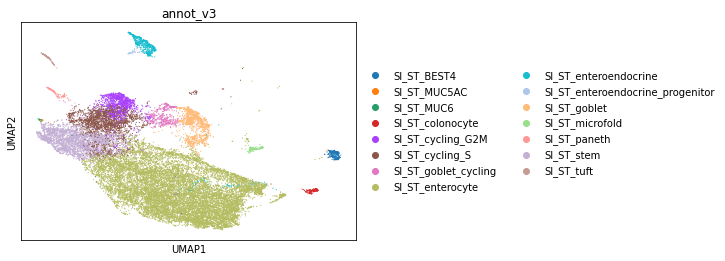

In [8]:
adata_nodoublets = adata[~adata.obs.annot_v3.isin(['Doublets'])].copy()
sc.pl.umap(adata_nodoublets,color='annot_v3')

In [9]:
#recover raw
adata_nodoublets.X = adata_nodoublets.layers['counts']

In [10]:
adata_nodoublets.X.max()

15557.0

In [11]:
adata_nodoublets.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/pre_scvi20221124/no_doublets/SI_ST_epi.raw.annotv3.nodoublets.20221206.h5ad')

## Plots for figures

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
#make figures for paper

In [3]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/SI_ST_epi.hvg5000_noRPL.scvi_output.annotv3.20221206.h5ad')

In [4]:
annot = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/healthy_annotations_level1to3_20230127.csv',index_col=0)

In [5]:
annot2 = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/pooled_healthy_disease.plus_additional_epi.18485genes.with_fineannot.nodoublets.20230322.csv',index_col=0)

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3437: DtypeWarning: Columns (3,5,6,8,9,11,12,14,62,63,64,65,66,67,70,73,75,82,83,84,86,92,93,95,100,101,102,105,106,108,109,111,112,113,114,115,117,119,123,124,125,126,127,128,129,130,131,132,133) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [6]:
adata.obs['fine_annot'] = annot.level_3_annot
adata.obs['fine_annot2'] = annot2.level_3_annot

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


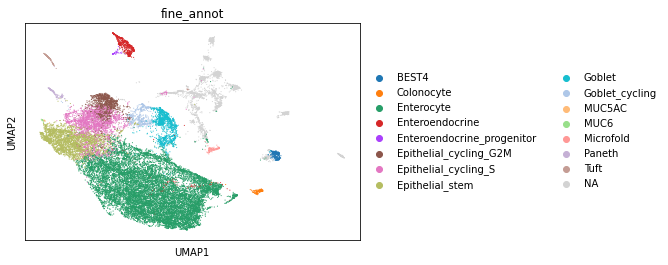

In [7]:
sc.pl.umap(adata,color='fine_annot')

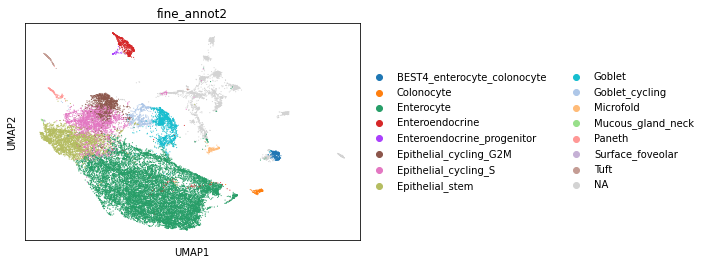

In [8]:
sc.pl.umap(adata,color='fine_annot2')

In [9]:
pd.crosstab(adata.obs.fine_annot,adata.obs.fine_annot2)

fine_annot2,BEST4_enterocyte_colonocyte,Colonocyte,Enterocyte,Enteroendocrine,Enteroendocrine_progenitor,Epithelial_cycling_G2M,Epithelial_cycling_S,Epithelial_stem,Goblet,Goblet_cycling,Microfold,Mucous_gland_neck,Paneth,Surface_foveolar,Tuft
fine_annot,,,,,,,,,,,,,,,
BEST4,298,0,0,0,0,0,0,0,0,0,0,0,0,0,0
Colonocyte,0,145,0,0,0,0,0,0,0,0,0,0,0,0,0
Enterocyte,0,0,13743,0,0,0,0,0,0,0,0,0,0,0,0
Enteroendocrine,0,0,0,709,0,0,0,0,0,0,0,0,0,0,0
Enteroendocrine_progenitor,0,0,0,0,44,0,0,0,0,0,0,0,0,0,0
Epithelial_cycling_G2M,0,0,0,0,0,1160,0,0,0,0,0,0,0,0,0
Epithelial_cycling_S,0,0,0,0,0,0,2114,0,0,0,0,0,0,0,0
Epithelial_stem,0,0,0,0,0,0,0,2976,0,0,0,0,0,0,0
Goblet,0,0,0,0,0,0,0,0,1215,0,0,0,0,0,0


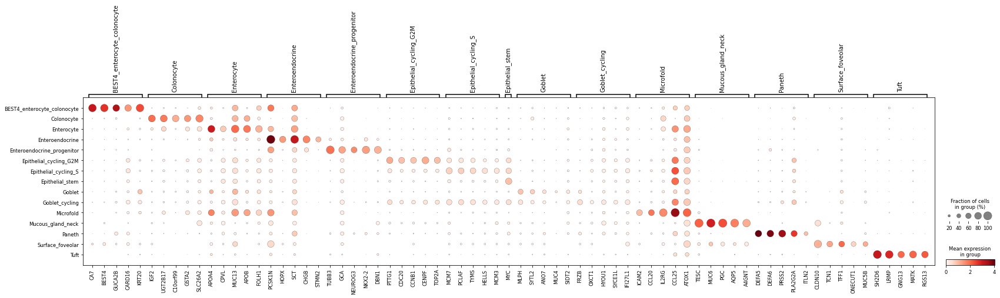

In [10]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="fine_annot2")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='fine_annot2', mks=mks)

In [11]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams['figure.figsize'] = [5,5]
sc.set_figure_params(dpi=300,dpi_save=600)

In [12]:
marker_genes_dict = { 'BEST4 Enterocyte':['BEST4','CA7','OTOP2','CFTR'],
                     'Colonocyte':['CA1','IGF2','GSTA2'],
                        'Enterocyte':['APOA4','PCK1','RBP2','SI'],
                     'Enteroendocrine':['CHGA','PCSK1N','SCT','SCGN','NEUROD1'],
                     'Enteroendocrine progenitor':['KLK12','NEUROG3','TUBB3','SOX4'],
                      'Cycling markers':['TOP2A','CCNB1','MKI67','PCLAF','GINS2','PCNA'],
                     'Stem':['LGR5','MYC'],
                     'Goblet':['MUC2','TFF3','FCGBP','ZG16'],
                      'Microfold':['IL2RG','ICAM2','CCL20','CCL25'],
                      'MUC5AC':['MUC5AC','TFF1','TCN1','MUC5B'],
                     'MUC6':['MUC6','AQP5','BPIFB1','PGC'],
                    
                     'Paneth':['DEFA6','DEFA5','REG3A','PLA2G2A'],
                    
                     'Tuft':['SH2D6','LRMP','MATK','FYB1','HPGDS','POU2F3', 'TRPM5']
                     }

In [13]:
list(adata.obs.fine_annot2.unique())

['Enterocyte',
 nan,
 'Microfold',
 'Goblet',
 'Enteroendocrine_progenitor',
 'Enteroendocrine',
 'Epithelial_stem',
 'BEST4_enterocyte_colonocyte',
 'Epithelial_cycling_S',
 'Paneth',
 'Mucous_gland_neck',
 'Tuft',
 'Goblet_cycling',
 'Colonocyte',
 'Epithelial_cycling_G2M',
 'Surface_foveolar']

In [14]:
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='fine_annot2',save='Epi_SI_ST_markers.pdf',color_map='RdBu_r', standard_scale='var')

In [15]:
adata2 = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/post_scvi20230126/SI_ST_epi.hvg5000_noRPL.scvi_output_nocatcovar.fine_annot.20230126.h5ad')

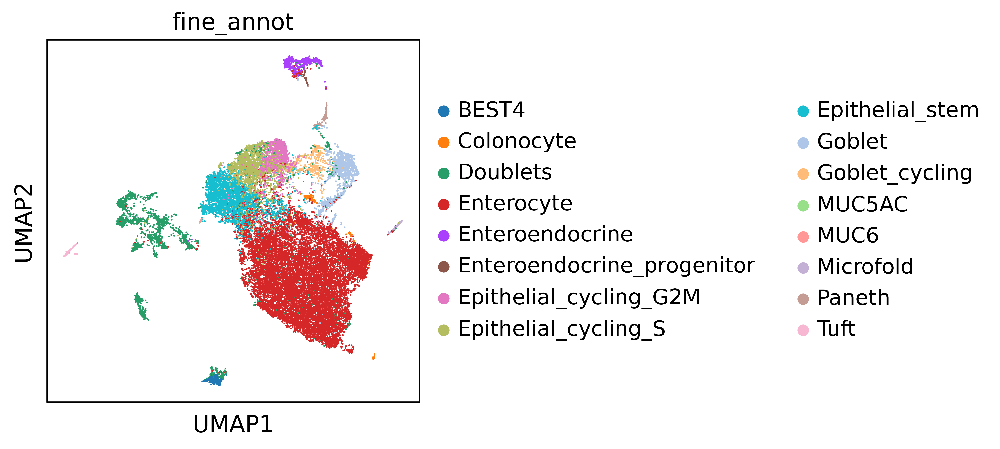

In [16]:
sc.pl.umap(adata2,color='fine_annot')

In [17]:
adata = adata[adata.obs.fine_annot2.isin(['Enterocyte',
 'Microfold',
 'Goblet',
 'Enteroendocrine_progenitor',
 'Enteroendocrine',
 'Epithelial_stem',
 'BEST4_enterocyte_colonocyte',
 'Epithelial_cycling_S',
 'Paneth',
 'Mucous_gland_neck',
 'Tuft',
 'Goblet_cycling',
 'Colonocyte',
 'Epithelial_cycling_G2M',
 'Surface_foveolar'])].copy()

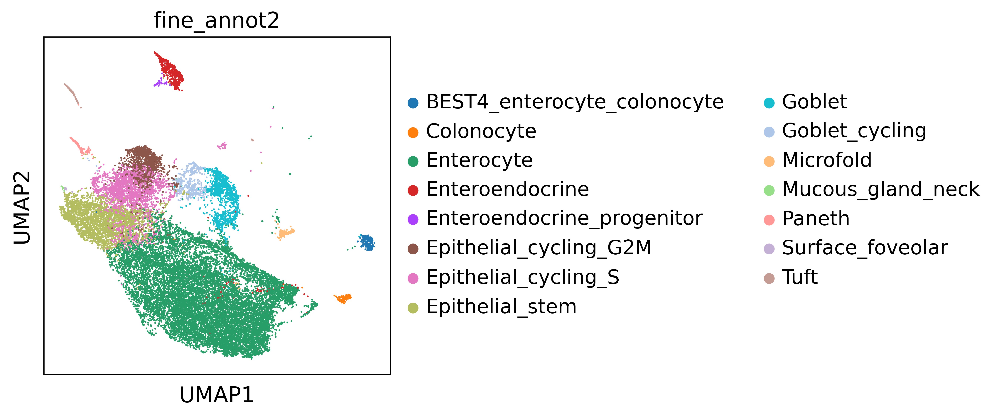

In [18]:
sc.pl.umap(adata,color='fine_annot2')

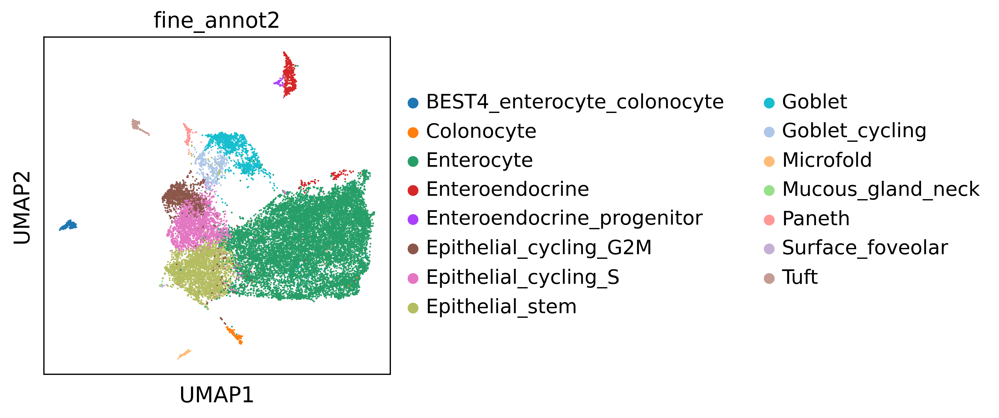

In [19]:
sc.pp.neighbors(
            adata,
            use_rep="X_scvi",
            n_pcs=adata.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(adata, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(adata, color='fine_annot2')

In [20]:
adata.obs['fine_annot2'].cat.reorder_categories([ 'BEST4_enterocyte_colonocyte',
'Colonocyte','Enterocyte', 'Enteroendocrine', 'Enteroendocrine_progenitor', 'Epithelial_cycling_G2M',
 'Epithelial_cycling_S', 'Epithelial_stem', 'Goblet', 'Goblet_cycling', 'Microfold',  'Surface_foveolar','Mucous_gland_neck',
                  
 'Paneth',

 'Tuft'                              

       ], inplace=True)

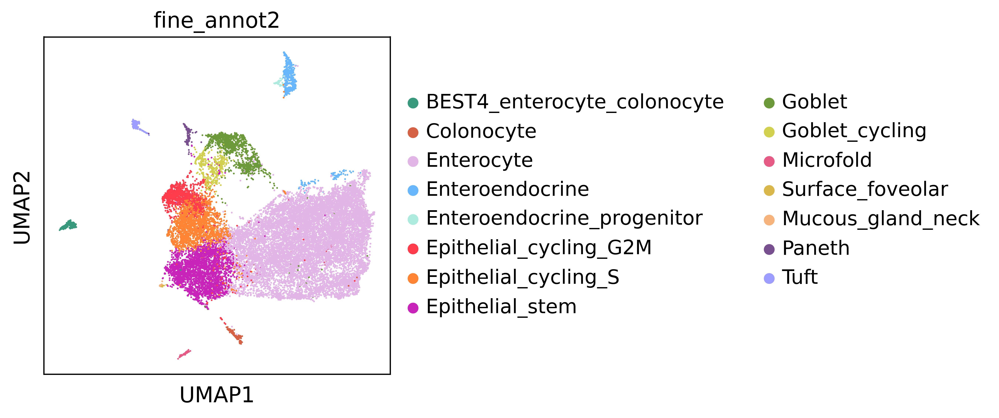

In [21]:
sc.pl.umap(adata,color='fine_annot2',palette = ['#39997c',#BEST4
                                                '#d66245',#Colonocyte
                                               '#e1b5e6',#enterocyte
                                                '#68b7fc',#enteroendocrine
                                               '#aeebdf',#'Enteroendocrine_progenitor': 
                                               '#ff3c4b',#'Epithelial_cycling_G2M': 
                                             '#ff8433',# 'Epithelial_cycling_S': 
                                                 '#c924b9',#stem
                                               '#6c9939',#goblet
                                               '#d1d14f',#goblet_cycling
                                              '#e55b85',#Microfold
                                               
                                               '#d9b74a',#MUC5AC
                                               '#f7b37c',#MUC6
                                               
                                               '#79508f',#paneth
                                             
                                               '#9d9dff',#tuft
                                               
                                               
    
    
                                              ])

In [22]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams['figure.figsize'] = [5,5]
sc.set_figure_params(dpi=300,dpi_save=600)

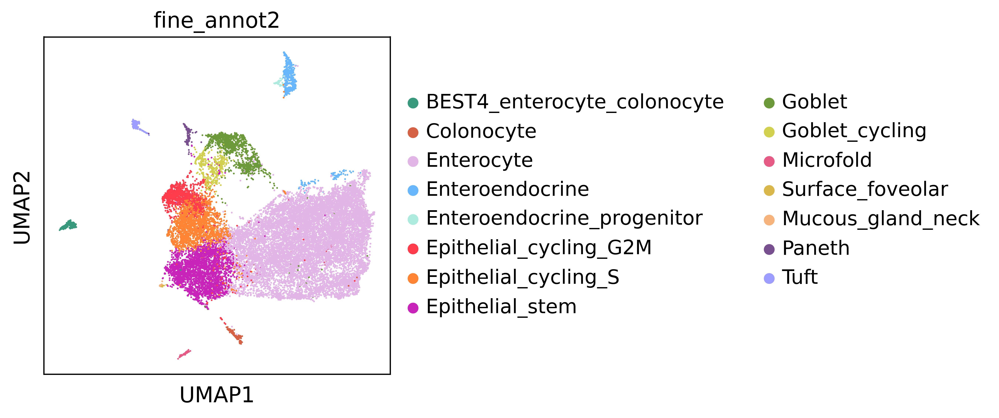

In [23]:
sc.pl.umap(adata,color='fine_annot2',save='Epi_SI_ST_annot.png')

<AxesSubplot: title={'center': 'fine_annot2'}, xlabel='UMAP1', ylabel='UMAP2'>

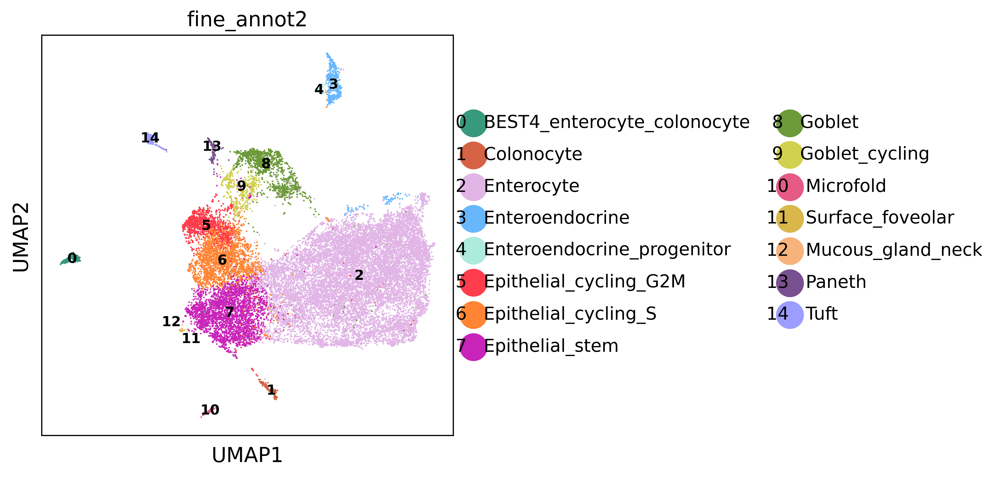

In [24]:
import sctk as sk
sk.plot_embedding(
    adata,
    basis="umap",
    groupby="fine_annot2",
    figsize=(5, 5),
    save='figures/Epi_SI_ST_annot.png')